<h2>How to use the photosom class</h2>
PhotoSOM is a Kohonen Map based framework for evaluating photometric redshift estimation methods with statistical tests.

It takes 2D numpy arrays as input, with (redshift)+(number of filters) columns and (number of galaxies) rows

In [1]:
import photosom as ps
import numpy as np
import matplotlib.pyplot as plt
from astropy.table import Table
import pandas as pd
import altair as alt

train_raw = Table.read('datasets/Spectroscopic_sample.fits', format='fits')
test_raw = Table.read('datasets/Target_sample.fits', format='fits')

# redshift, g, r, i, z
train = np.column_stack((train_raw['Z_true'], train_raw['MAG_G'], train_raw['MAG_R'], train_raw['MAG_I'], train_raw['MAG_Z']))
test = np.column_stack((test_raw['Z_true'], test_raw['MAG_G'], test_raw['MAG_R'], test_raw['MAG_I'], test_raw['MAG_Z']))

The initialization takes training data, testing data, and an optional seed for the random state for reproduceable results

In [2]:
def colorPlot(filter1, filter2, x_values, data, title, xtitle, xbins, ybins, width=250, height=250):
    temp = pd.DataFrame({'y':data[filter1]-data[filter2], 'x':data[x_values]})
    return alt.Chart(temp).mark_rect().encode(
        alt.X('x:Q', bin=xbins, axis=alt.Axis(title=xtitle)),
        alt.Y('y:Q', bin=ybins, axis=alt.Axis(title=filter1[-1]+"-"+filter2[-1])),
        alt.Color('count(y):Q', scale=alt.Scale(scheme='lightmulti', type='log'))
    ).properties(
        title=title,
        width=width,
        height=height
    )

pd_train_full = pd.DataFrame({'true_z':train_raw['Z_true'], 'mag_g':train_raw['MAG_G'], 'mag_r':train_raw['MAG_R'],
                         'mag_i':train_raw['MAG_I'], 'mag_z':train_raw['MAG_Z']})

pd_test_full = pd.DataFrame({'true_z':test_raw['Z_true'], 'mag_g':test_raw['MAG_G'], 'mag_r':test_raw['MAG_R'],
                         'mag_i':test_raw['MAG_I'], 'mag_z':test_raw['MAG_Z']})

n_bins = 75
xbins = alt.Bin(extent=[0,2], step=2./n_bins)
ybins = alt.Bin(extent=[-0.7,2.5], step=3.2/n_bins)

ri_train = colorPlot('mag_r', 'mag_i', 'true_z', pd_train_full,
                     'Galaxies in r-i color, Training Set', 'True Redshift (z)',
                     xbins, ybins)
ri_test = colorPlot('mag_r', 'mag_i', 'true_z', pd_test_full,
                    'Galaxies in r-i color, Test Set', 'True Redshift (z)',
                     xbins, ybins)

ri_train | ri_test

alt.HConcatChart(...)

In [3]:
pz = ps.PhotoSOM(train, test, random_seed=338042)

73274 training and 133717 testing galaxies initialized


In [4]:
z_cutoff_range = [0, 3.1]      # [0, 3.1]    for complete data
mag_cutoff_range = [14, 25.5]  # [14, 25.5]  for complete data
percentile_cut = 0.0           # 0.0         for complete data
n_bins = 100

pz.assignRange(z_cutoff_range, mag_cutoff_range, mag_filter=2)
pz.selectionFunction(30, percentile_cut, filter1=1, filter2=2)

In [5]:
gaussian_pdfs = pz.idealGaussian(0.05, 0.05)
pz.predictionPlot(title="Predicted Redshfits vs. Truth Values")

There are 73271 training galaxies selected


alt.LayerChart(...)

In [6]:
ml_pdfs = pz.randomForestTraining()
pz.predictionPlot(title="Predicted Redshfits vs. Truth Values")

There are 73271 training galaxies selected
2 bins missing, [95 96]


alt.LayerChart(...)

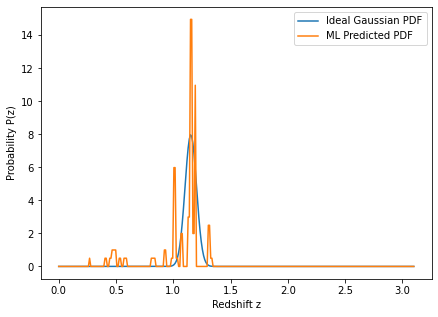

In [7]:
n = np.random.randint(len(pz.pdfs))
x = np.linspace(0, 3.1, 300)

f = plt.figure(figsize=(7,5))
plt.plot(x, gaussian_pdfs[n].pdf(x))
plt.plot(x, ml_pdfs[n].pdf(x))
plt.legend(['Ideal Gaussian PDF', 'ML Predicted PDF'])
plt.xlabel('Redshift z')
plt.ylabel('Probability P(z)')
plt.show()

In [8]:
pz.initSOM(20)

In [9]:
pz.colorMap(title="r-i Color per SOM Cell")

alt.Chart(...)

In [10]:
pz.densityMap(title="Galaxy Density")

alt.Chart(...)

In [11]:
pz.chiSquaredMap(title="Chi Squared per DOF Value")

alt.Chart(...)

In [12]:
pz.chiSquaredTest(title="Null Hypothesis Test")

Failure Rate: 58.25%


alt.Chart(...)

In [13]:
pz.cdfHistogram()

alt.Chart(...)